In [1]:
import os
import tensorflow_datasets as tfds

os.environ["CUDA_VISIBLE_DEVICES"] = ""

In [2]:
ds = tfds.load("ego4d_hamer", data_dir="/raid/datasets/openx", split='train')

2025-01-17 14:26:45.116258: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-01-17 14:26:45.147986: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-01-17 14:26:45.148009: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-01-17 14:26:45.149175: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-01-17 14:26:45.161465: I tensorflow/core/platform/cpu_feature_guar

In [3]:
for episode in ds.take(10):
    step = next(iter(episode["steps"]))
    print(step["language_instruction"])

tf.Tensor(b'C picks another cup from the kitchen sink', shape=(), dtype=string)
tf.Tensor(b'C holds the towel', shape=(), dtype=string)
tf.Tensor(b'C places his right hand on the chair of the lawn mower. ', shape=(), dtype=string)
tf.Tensor(b'C sweeps the road.', shape=(), dtype=string)
tf.Tensor(b'C loses the cut off wheel from the angle grinder with his right hand.', shape=(), dtype=string)
tf.Tensor(b'C takes lid ', shape=(), dtype=string)
tf.Tensor(b'C kneads the cut dough on the kneading table with his gloved hands.', shape=(), dtype=string)
tf.Tensor(b'C pulls out the grass with his left hand', shape=(), dtype=string)
tf.Tensor(b'C removes the pieces of wood from the vise with his right hand.', shape=(), dtype=string)
tf.Tensor(b'C picks up an orange bowl from the baking table with her right hand.', shape=(), dtype=string)


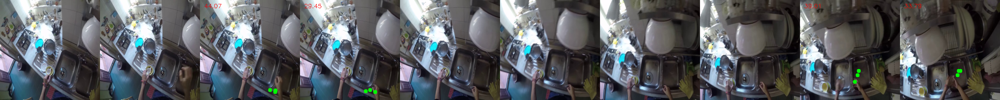

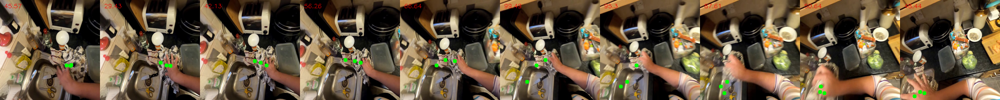

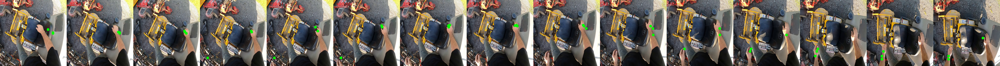

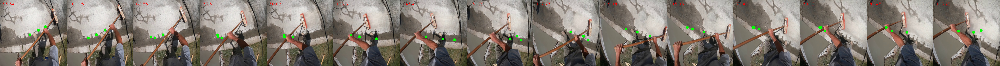

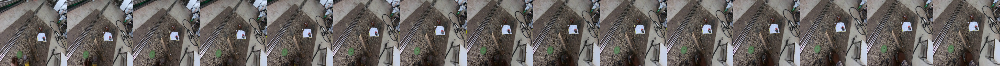

...

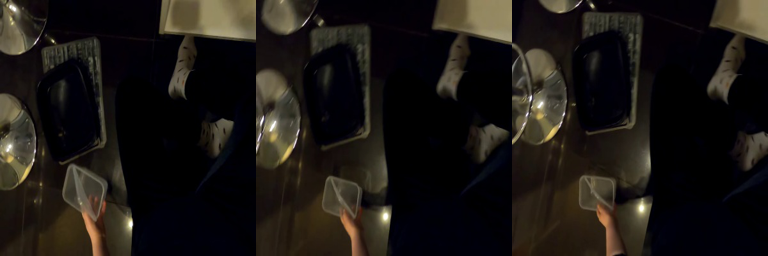

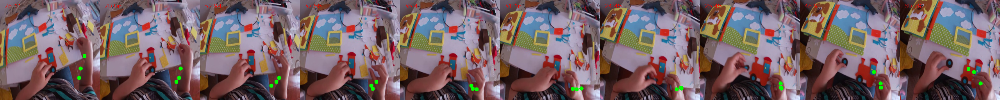

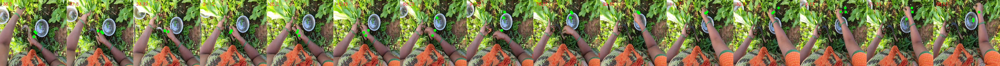

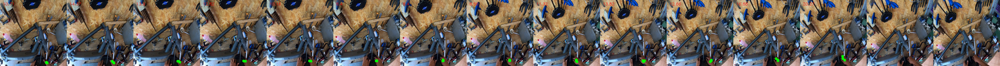

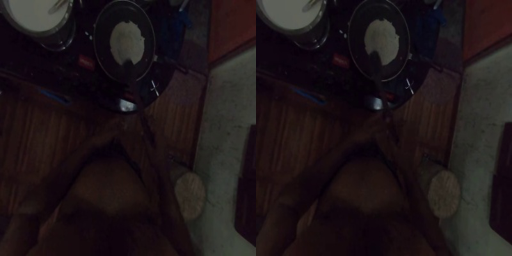

In [4]:
import numpy as np
import cv2
from IPython.display import display
from PIL import Image

def no_detect(act):
    return act[0] == 0 and act[1] == 0


for episode in ds.take(20):
    images = []
    actions = []
    for step in episode["steps"]:
        images.append(step["observation"]["ego_image_1"].numpy())
        actions.append(step["action_dict"]["right"]["hand_center"].numpy())
    
    img_strip = []
    for i, img in enumerate(images[:min(15, len(images)-3)]):
        img = np.asarray(img, dtype=np.float32) / 255.
        if all([not no_detect(actions[i + k]) for k in range(4)]):
            d_act_norm = 0
            for k in range(3):
                img = cv2.circle(img, (int(actions[i + k + 1][0]), int(actions[i + k + 1][1])), 5, (0, 1, 0), -1)
                d_act_norm += np.linalg.norm(actions[i + k + 1] - actions[i + k])
            cv2.putText(img, f"{np.round(d_act_norm, 2)}", (10, 20), cv2.FONT_HERSHEY_SIMPLEX, 0.5, 10)
        img_strip.append(img)

    # plt.figure(figsize=(15, 15*len(images)))
    display(Image.fromarray(np.asarray(np.concatenate(img_strip, axis=1) * 255, dtype=np.uint8)))
    

In [5]:
actions_for_missed_detection_stats = []
for episode in ds.take(1000):
    for step in episode["steps"]:
        actions_for_missed_detection_stats.append(step["action_dict"]["right"]["hand_center"].numpy())

In [6]:
missed = 0
for act in actions_for_missed_detection_stats:
    if act[0] == 0 and act[1] == 0:
        missed += 1
print(f"Missed hand detections: {missed / len(actions_for_missed_detection_stats) * 100}%")

Missed hand detections: 22.373320382062488%


In [7]:
def no_detect(act):
    return act[0] == 0 and act[1] == 0

delta_act_norms = []
delta_act_max_norms = []
skipped = 0
for episode in ds.take(1000):
    episode_acts = []
    for step in episode["steps"]:
        episode_acts.append(step["action_dict"]["right"]["hand_center"].numpy())
    
    for i in range(len(episode_acts)-3):
        if all([not no_detect(episode_acts[i + k]) for k in range(4)]):
            d_act_norm_i = []
            for k in range(3):
                d_act_norm_i.append(np.linalg.norm(episode_acts[i + k + 1] - episode_acts[i + k]))
            delta_act_norms.append(sum(d_act_norm_i))
            delta_act_max_norms.append(max(d_act_norm_i))
        else:
            skipped += 1

In [8]:
print(f"Filtered transitions: {skipped / (skipped + len(delta_act_norms)) * 100}%")


Filtered transitions: 32.489858991694035%


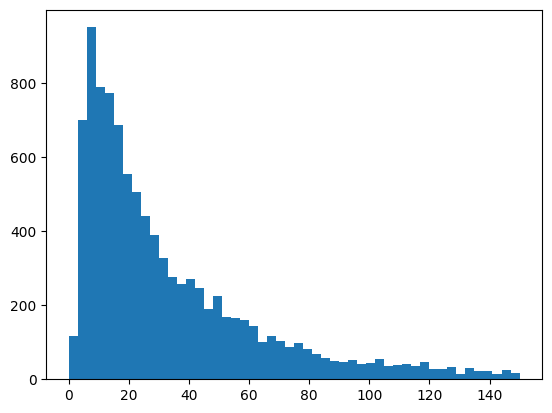

In [9]:
import matplotlib.pyplot as plt

dtn = np.array(delta_act_norms)
plt.hist(dtn[dtn < 150], bins=50)
plt.show()

In [10]:
n_valid = 0
n_valid_max_filtered = 0
for dan, dmn in zip(delta_act_norms, delta_act_max_norms):
    if dan > 20 and dan < 150:
        n_valid += 1
    if dan > 20 and dan < 150 and dmn < 100:
        n_valid_max_filtered += 1
print(f"Valid transitions (w/o max filtering): {n_valid / len(delta_act_norms) * 100}%")
print(f"Valid transitions (w/ max filtering): {n_valid_max_filtered / len(delta_act_norms) * 100}%")

Valid transitions (w/o max filtering): 51.24463519313305%
Valid transitions (w/ max filtering): 50.329041487839774%


In [11]:
print("Number of transitions after curation: ", (len(delta_act_norms) + skipped) / 1000 * 64236 * 0.7 * 0.5)


Number of transitions after curation:  349177.2606
